<a href="https://colab.research.google.com/github/ccsuehara/capp-30239-w20-A01/blob/development/hw5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import world_bank_data as wb
import altair as alt
import pandas as pd
import regex as re
from google.colab import drive
from google.colab import files

drive.mount('/content/drive')
from chorogrid import Colorbin, Chorogrid
import json
import urllib.request
import geopandas as gpd
import numpy as np

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
alt.data_transformers.disable_max_rows()


In [0]:
#pip install world-bank-data
#pip install geopandas  
#pip install chorogrid


#**Understanding the Skills we need in life (the adult version)** 
The purpose of this project is to explore and understand the relations that exist between education, economic growth, and the skills we develop through education, that are necessary to compete in an economy where knowledge is a key piece for development. The world is currently in an education crisis, where going to school is not the same as learning. This is true for children who are curently in the school, but moreso, for adults who are part of the workforce and have, supposedly, consolidated their skills by then. This exploration focuses on individuals that are old enough to work and the differences between countries. 

### **About my data**
The data I used for this project proceed from the following sources

1.   ###### **[The World Development Indicators](https://datacatalog.worldbank.org/dataset/world-development-indicators)** were acessed throught the API library available for python. 
2.   ###### **[The Barro-Lee education datasets](http://www.barrolee.com)** were obtained directly through the available links. 
3.  ###### **[The OECD's Programme for the International Assessment of Adult Competencies(PIAAC) datasets ](https://www.oecd.org/skills/piaac/data/)** were also obtained directly through the links 






##### Preparing the data

In [0]:
url_ = "https://raw.githubusercontent.com/mustafasaifee42/Tile-Grid-Map/master/Tile-Grid-Map-Cleaned.json"
with urllib.request.urlopen(url_) as url:
    data = json.loads(url.read().decode())


In [72]:
coord_dic = {}
coord_dic['country'] = []
coord_dic['square_x'] = []
coord_dic['square_y'] = []
coord_dic['abbrev'] = []


for country in data:
  coord_dic['country'].append(country['name'])
  coord_dic['square_x'].append(country['coordinates'][0]) 
  coord_dic['square_y'].append(country['coordinates'][1])
  coord_dic['abbrev'].append(country['alpha-2'])
coord_df = pd.DataFrame.from_dict(coord_dic)
coord_df['abbrev'].loc[coord_df['country'] =='Namibia'] = 'NAM'

coord_df.to_csv("coord_csv.csv")
files.download("coord_csv.csv")

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


In [71]:
coord_df[coord_df['country'] =='Namibia']

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


,country,square_x,square_y,abbrev
120,Namibia,15,19,NAM


In [49]:
#@title Needed functions and defining theme

#Functions
def add_cols(df,lst_cols,new_col):
    df[new_col] = 0
    for col in lst_cols:
        df[new_col] += df[col]

def mytheme():
    font = "Rockwell"
    labelFont = "Rockwell"
    sourceFont = "Rockwell"
    
    return {
        "config" : {
             "title": {'font': font, 
                       'fontSize': 30,
                       'fontWeight': 600,
                       'offset':20,
                       'anchor':'middle'},
             "axis": {
                  "labelFont": font,
                  "titleFont": font,
                  "domainColor": "slategray"
             },
             "header": {
                  "labelFont": font,
                  "titleFont": font
             },
             "legend": {
                  "labelFont": font,
                  "titleFont": font,
                  "symbolType": 'circle',
                  "padding": 1
                  
             }
             #,
             #'background': 'snow'             
        }
    }

alt.themes.register('mytheme', mytheme)
alt.themes.enable('mytheme')


ThemeRegistry.enable('mytheme')

In [35]:
#@title Code for Barro-Lee datasets
#Barro Lee dataset
bl_link = "http://www.barrolee.com/data/BL_v2.2/BL2013_MF2599_v2.2.csv"
bl_link_f = "http://www.barrolee.com/data/BL_v2.2/BL2013_F2599_v2.2.csv"
bl_link_m = "http://www.barrolee.com/data/BL_v2.2/BL2013_M2599_v2.2.csv"


bl = pd.read_csv(bl_link)

#creating the total population
add_cols(bl,['lu','lp','ls','lh'],'total')

ed_levels = ['lu','lp','ls','lh']

for ed in ed_levels:
    bl['p_{}'.format(ed)] = bl['pop']*bl[ed]/100

# #creating new columns for more education levels
bl['No Level'] = bl['p_lu']
bl['Primary'] =  bl['p_lp']
bl['Secondary'] = bl['p_ls']
bl['Tertiary'] =  bl['p_lh']

#ed_levels = ['No Level', 'Primary', 'Secondary', 'Tertiary']


order_lst = ["No Level",
              "Primary","Secondary","Tertiary"]

region_dic = {'Middle East and North Africa':'ME and NA', 'Sub-Saharan Africa': 'SSA',
       'Latin America and the Caribbean': 'LAC', 'Advanced Economies':'AE',
       'South Asia': 'SA', 'East Asia and the Pacific':'EAP',
       'Europe and Central Asia':'ECA'}

#First graph: Population 
experiment = bl[["Tertiary","Secondary",
                 "Primary","No Level",
                 "year"]].groupby(("year")).sum()

experiment = experiment.stack().to_frame().reset_index()
experiment = experiment.rename(columns = {"level_1":"Educational Attainment", 0: "number"})

#experiment['Educational Attainment'] =experiment['Educational Attainment'].apply(lambda x: level_change[x])

order = {"No Level":0,"Primary":1,
                "Secondary":2,"Tertiary":3}

experiment['order'] =experiment['Educational Attainment'].apply(lambda x: order[x])

experiment3 = bl[(bl['year'] == 1950) | (bl['year'] == 2010)]


experiment3 = experiment3[["Tertiary","Secondary",
                 "Primary","No Level",
                 "year", "region_code"]].groupby(("year","region_code")).sum().reset_index()


#experiment3 = experiment3[ed_levels + ["year", "country", "region_code"]]

experiment3 = experiment3.melt(['year','region_code'],
                               var_name = "Education Level", value_name = "perc")

#experiment3['Education Level'] =experiment3['Education Level'].apply(lambda x: level_change[x])
experiment3['region'] =experiment3['region_code'].apply(lambda x: region_dic[x])

experiment4 = bl[(bl['year'] == 1950)| (bl['year'] == 2010)]
experiment4 = experiment4[["year", "country", "yr_sch"]]

experiment5 = bl[(bl['year'] == 1950)| (bl['year'] == 2010)]
experiment5 = experiment5[["year", "country", "yr_sch", "region_code"]]

experiment5 = experiment5.groupby(("year","region_code")).mean().reset_index()


first_graph = alt.Chart(experiment4, width = 1000).mark_line().encode(
    alt.X('year:O',scale=alt.Scale(domain=(1950, 2010), zero = False)),
    y='yr_sch',
    color=alt.Color('region_code:O', legend = None,scale=alt.Scale(scheme='greenblue'))
)

second_graph = alt.Chart(experiment5, width = 1000).mark_line().encode(
    alt.X('year:O',scale=alt.Scale(domain=(1950, 2010), zero = False)),
    y='yr_sch',
    color=alt.Color('region_code'))


#experiment4 = experiment4[["yr_sch",
#                 "year", "country", "region_code"]].groupby(("year","region_code")).sum().reset_index()


experiment6 = bl[(bl['year'] == 2010)]
experiment6 = experiment6[["yr_sch", "region_code", "WBcode"]]
gdp_pcap = wb.get_series('NY.GDP.PCAP.KD', date='2010', id_or_value='id', simplify_index=True)
gdp_pcap = gdp_pcap.to_frame().reset_index()
gdp_pcap.columns = ["WBcode", "GDP_pcap"]
exp = experiment6.merge(gdp_pcap, on = 'WBcode')

experiment3['order'] =experiment3['Education Level'].apply(lambda x: order[x])
tot = experiment3[['year','region_code','perc']].groupby(('year','region_code')).sum().reset_index()
experiment3 = experiment3.merge(tot, on = ("region_code","year"))
experiment3['slope'] = (experiment3['perc_x']/experiment3['perc_y'])*100



/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:53: FutureWarning: Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:70: FutureWarning: Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:97: FutureWarning: Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.


In [80]:
order_pv['lev_educ'].unique()

array(['Secondary'], dtype=object)

In [81]:
#@title Code for PIAAC datasets
piaac_countries = {'aut': 'Austria','bel': 'Belgium',
 'chl': 'Chile','cze': 'Czech Republic','dnk': 'Denmark','fin': 'Finland',
 'fra': 'France','deu': 'Germany','grc': 'Greece','irl': 'Ireland',
 'isr': 'Israel','ita': 'Italy','jpn': 'Japan','kor': 'Korea','ltu': 'Lithuania',
 'nld': 'Netherlands','nzl': 'New Zealand','nor': 'Norway','pol': 'Poland',
 'rus': 'Russian Federation','sgp': 'Singapore','svk': 'Slovak Republic','svn': 'Slovenia',
 'esp': 'Spain','swe': 'Sweden', 'tur': 'Turkey','gbr': 'United Kingdom',
 'usa': 'United States','ecu': 'Ecuador','hun': 'Hungary','kaz': 'Kazakhstan',
 'mex': 'Mexico','per': 'Peru','can': 'Canada','est': 'Estonia'}

#Variables we need to work with
var = "B_Q01A spfwt0 ageg5lfs yrsqual d_q13a d_q13b d_q13c ISCOSKIL4 \
LITSTATUS PVLIT1 PVLIT2 PVLIT3 PVLIT4 PVLIT5 PVLIT6 PVLIT7 PVLIT8 PVLIT9 PVLIT10 \
NUMSTATUS PVNUM1 PVNUM2 PVNUM3 PVNUM4 PVNUM5 PVNUM6 PVNUM7 PVNUM8 PVNUM9 PVNUM10 age_r earnhr earnhrppp" 
var_lst = var.upper()
var_lst =  re.sub(" ", ",", var_lst)
var_lst = var_lst.split(",")

for i, val in enumerate(var_lst):
  if val == 'B_Q01A':
    var_lst[i]= 'B_Q01a'
  if val == 'D_Q13A':
    var_lst[i]= 'D_Q13a'
  if val == 'D_Q13B':
    var_lst[i]= 'D_Q13b'
  if val == 'D_Q13C':
    var_lst[i]= 'D_Q13c'

#Alternative way of obtaining from outside my drive:
# df_piaac = pd.DataFrame()
# for cntr in piaac_countries.keys():
#   link = "https://webfs.oecd.org/piaac/puf-data/CSV/prg{}p1.csv".format(cntr).strip(" ")
#   piaac = pd.read_csv(link, usecols = var_lst)
#   piaac['country_name'] = piaac_countries[cntr]
#   df_piaac = df_piaac.append(piaac)


df_piaac = pd.DataFrame()
for cntr in piaac_countries.keys():
  link = "/content/drive/My Drive/piaac csvs/prg{}p1.csv".format(cntr).strip(" ")
  piaac = pd.read_csv(link, usecols = var_lst)
  piaac['country_name'] = piaac_countries[cntr]
  df_piaac = df_piaac.append(piaac)

isced_dic = {1:0,2:1,3:2,4:2,5:2,6:2,7:2,8:2,10:3,9:4,11:5,12:5,13:5,14:5,16:5}
isced_educ = {0:0,1:1,2:3,3:3,4:3,5:4}
educ_lev = {0:'No School',1:'Primary',3:'Secondary',4:'Tertiary'}

df_piaac['ISCED'] = df_piaac.B_Q01a.map(isced_dic)
df_piaac['educ'] = df_piaac.ISCED.map(isced_educ)
df_piaac['lev_educ'] = df_piaac.educ.map(educ_lev)


df_piaac['pvlit'] = df_piaac[['PVLIT1','PVLIT2','PVLIT3','PVLIT4','PVLIT5',
                  'PVLIT6','PVLIT7','PVLIT8','PVLIT9','PVLIT10']].mean(axis=1)
df_piaac['pvnum'] = df_piaac[['PVNUM1','PVNUM2','PVNUM3','PVNUM4','PVNUM5',
                              'PVNUM6','PVNUM7','PVNUM8','PVNUM9','PVNUM10']].mean(axis=1)


# alt.Chart(df_piaac).mark_circle().encode(
#     alt.X('country_name:N', axis=alt.Axis(labelAngle=0)),
#     y = 'median(pvlit)',
#     color = alt.Color('educ:N', legend=None)
#     )

order_pv = df_piaac[['pvlit','country_name','pvnum', 'lev_educ']].groupby(('country_name','lev_educ')).mean().reset_index() 
mask = order_pv['lev_educ'] == "Tertiary"
order_pv = order_pv[mask]
order_pv = order_pv.sort_values(by = 'pvnum', ascending = False)
order_pv['sort'] = range(len(order_pv))
mean_pv = mean_pv.merge(order_pv[["country_name", "sort"]],on = "country_name")
mean_pv_lst = list(order_pv['country_name'])



eg9 = df_piaac[['country_name','pvnum']].groupby(('country_name')).mean().reset_index()
eg9 = eg9.merge(coord_df[['country', 'abbrev']],left_on="country_name", right_on="country")
eg9 = eg9.rename(columns = {"country_name": "country"})


/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (9,384) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)
/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (9,385) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)
/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,
/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (9) have mixed types. Specify dtype option on import or set low_mem

In [0]:
coord_df_dic = {"Côte d'Ivoire": "Cote dIvoire", "Tanzania": "United Republic of Tanzania",
                "Congo (Democratic Republic of the)": "Democratic Republic of the Congo", 
                "Dominican Republic": "Dominican Rep.", "Trinidad & Tobago":"Trinidad and Tobago",
                "United States of America":"USA", "South Korea":"Republic of Korea",
                "Syria":"Syrian Arab Republic", "Great Britain and Northern Ireland":"United Kingdom",
                "Libya":"Libyan Arab Jamahiriya", "Moldova (Republic of)": "Republic of Moldova",
                }
coord_df['country'] = coord_df['country'].replace(coord_df_dic)                
mask = bl['year'] == 2010 
bl_eg = bl[mask]

bl_eg = bl_eg[['country','lu']]
bl_eg = bl_eg.merge(coord_df[['country', 'abbrev']], on="country", indicator = True)

mask_bl = bl_eg._merge == "left_only"
mask_coord = bl_eg._merge == "right_only"

bl_bl = bl_eg[mask_bl]
bl_coord = bl_eg[mask_coord]

mask = bl['year'] == 2010 
bl_eg = bl[mask]
bl_eg = bl_eg[['country','lu']]
bl_eg = bl_eg.merge(coord_df[['country', 'abbrev']],on="country")

In [50]:
#bl[bl['country'] == 'Bahamas']
order_lst

['Tertiary', 'Secondary', 'Primary', 'No Level']

In [0]:
#df_piaac.to_csv("filename.csv",sep = ",")

###**Around the world, educational attainment has improved tremendously in 60 years.** 

In 1950, more than 50% of the world population didn't even start primary education. Moreover, less than 15% of the population had an education level greater than primary. 60 years after, the panorama has changed: More than 60% of the world population has at least, completed secondary. But is this enough? Tertiary education (higher education) has increased only to mean a little more than 10% of the total population. 

More so, the group of countries that constitute the advanced economies (AE) is the one that has augmented its educated population more quickly, as well as Europe and Central Asia (ECA). It's no surprise that Sub Saharan Africa is the one whose improvement has been slower than the rest of regions.

Note: the acronyms correspond to Advanced Economies(AE), East Asia and the Pacific(EAP), Europe and Central Asia(ECA), Latin America and the Caribean (LAC), the Middle East and North Africa(ME and NA), South Asia (SA) and Sub Saharan Africa (SSA).

In [0]:

order_lst = ["No Level",
              "Primary","Secondary","Tertiary"]

In [73]:
experiment.rename(columns={"Educational Attainment": "Education Level"}, inplace = True)

fig1 = alt.Chart(experiment, width = 500, height = 120).mark_area(
    line=True).encode(
    x=alt.X("year:O", axis = alt.Axis(labelAngle=1)),
    y=alt.Y("number:Q", stack="normalize", axis = alt.Axis(format = '%', title = "Percentage of population")),
    color=alt.Color("Education Level:N", sort = order_lst, title = "Education Level",
                    scale=alt.Scale(scheme='redblue')),
    order = "order:N"
)

fig2 = alt.Chart(experiment3, width = 100).mark_line().encode(
    y=alt.Y('year:N',sort=alt.EncodingSortField('y', order='descending')),
    x= alt.X('slope', axis = alt.Axis(title = "Percentage of population")),
    color = alt.Color('Education Level', sort = order_lst),
    row =alt.Column('region', title = "Regions of the world"),
    order=alt.Order('year', sort='ascending')
)

fig3 = alt.Chart(experiment, width = 500, height = 220).mark_area(
    line=True).encode(
    x=alt.X("year:O", axis = alt.Axis(labelAngle=1)),
    y=alt.Y("number:Q", axis = alt.Axis(title = "Total population")),
    color=alt.Color("Education Level:N", sort = order_lst, title = "Education Level",
                    scale=alt.Scale(scheme='redblue')),
    order = "order:N"
)

fig4 = alt.Chart(experiment3, height = 45).mark_bar().encode(
    x='year:O',
    y= alt.Y('perc_x',stack = 'normalize', axis = alt.Axis(format = '%', title = "% pop")),
    color=alt.Color("Education Level:N", sort = order_lst, title = "Education Level",
                    scale=alt.Scale(scheme='redblue')),
    row =alt.Row('region', title = "Regions of the world"),
    order = "order:N"
)

e = alt.vconcat(fig3,fig1)

alt.hconcat(e,fig4).properties(
    title={
      "text": ["Educational attainment around the world"], 
      "subtitle": ["Some regions show greater advances with respect to others",
                   "Source: Barro-Lee education datasets"] 
           })




alt.HConcatChart(...)

### **There are still many countries with a great percentage of adult population with no schooling.** 
The percentage of people with no schooling declined heavily in the last 60 years, nevertheless, to reinforce the idea of gaps between regions, when taking a look at countries in Africa and South East Asia, there is still a large proportion of people that haven't been able to access school. 



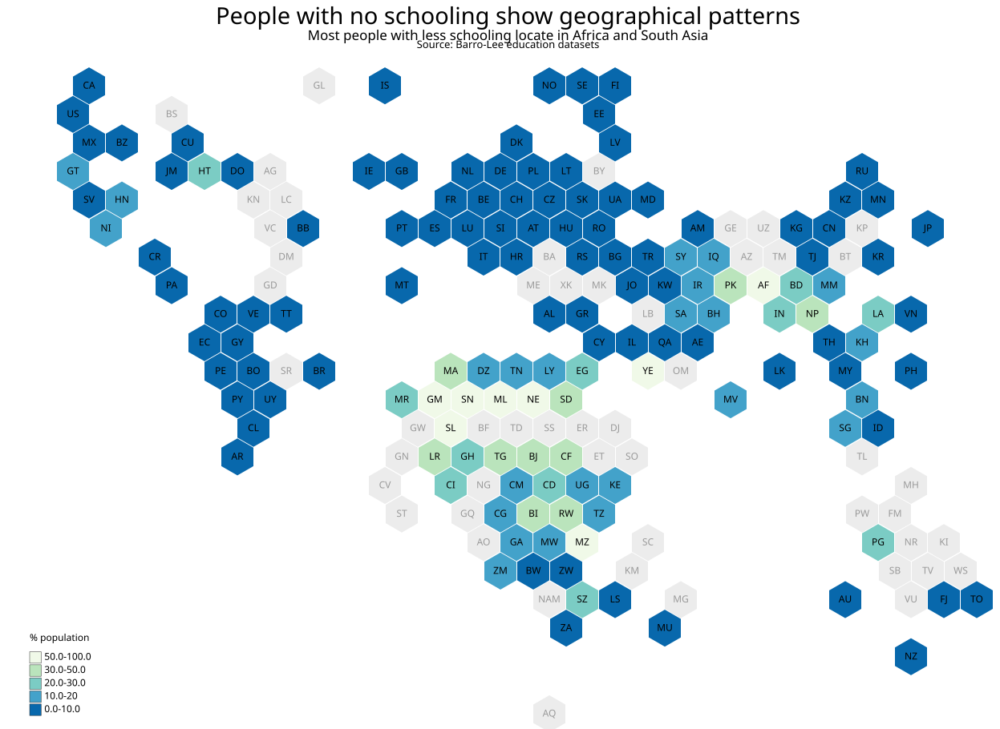

In [74]:
mycolors = [ '#0868ac', '#43a2ca', '#7bccc4', '#bae4bc','#f0f9e8']
mybin = Colorbin(bl_eg['lu'], mycolors, proportional=True, decimals=None)
mybin.set_decimals(0)
mybin.recalc(fenceposts=True)
mybin.fencepostlabels
mybin.calc_complements(0.5, '#e0e0e0', '#101010')
countries = list(bl_eg.abbrev)
colors_by_state = mybin.colors_out
font_colors_by_state = mybin.complements
legend_colors = mybin.colors_in
mybin.labels  = ['0.0-10.0', '10.0-20', '20.0-30.0', '30.0-50.0', '50.0-100.0']

legend_labels = mybin.labels

cg = Chorogridi("/content/coord_csv.csv", countries, colors_by_state)
cg.set_title('People with no schooling show geographical patterns',
             font_dict={'font-size': 29, 'font-family':'rockwell','font-style':'bold'})
cg.set_subtitle('Most people with less schooling locate in Africa and South Asia',
             font_dict={'font-size': 17, 'font-family':'rockwell','font-style':'normal'})
cg.set_subtitle2('Source: Barro-Lee education datasets',
             font_dict={'font-size': 13, 'font-family':'rockwell','font-style':'normal'})
cg.set_legend(legend_colors, legend_labels, title='% population')
cg.draw_hex(x_column='square_x', y_column='square_y',spacing_dict={'margin_right': 10,
                                                                   'legend_offset':[-1200,-10]}) # otherwise legend will be cut off
    # another strategy would be to pass a legend_offset to spacing_dict
cg.done(show=True)



In [0]:
#@title chorogrid modified class
#!/usr/bin/python
# Filename: Chorogrid.py

import xml.etree.ElementTree as ET
import pandas as pd
import re
import sys
from math import sqrt
from IPython.display import SVG, display

class Chorogridi(object):
    """ An object which makes choropleth grids, instantiated with:
            csv_path: the path to a csv data file with the following columns:
                * ids: e.g., states or countries, corresponding to
                       the Colorbin.colorlist
                * coordinates or path
            ids: a listlike object of ids corresponding to colors
            colors: a listlike object of colors in hex (#123456) format
                    corresponding to ids
            id_column: the name of the column in csv_path containing ids
                       if there is not a 1:1 map between the ids object
                       and the contents of id_column, you will be warned
            
        Methods (introspect to see arguments)
           set_colors: pass a new list of colors to replace the one
                       used when the class was instantiated
           set_title: set a title for the map
           set_legend: set a legend
           add_svg: add some custom svg code. This must be called
                      after the draw_... method, because it needs to know
                      the margins.
           
           draw_squares: draw a square grid choropleth
           draw_hex: draw a hex-based choropleth
           draw_multihex: draw a multiple-hex-based choropleth
           draw_multisquare: draw a multiple-square-based choropleth
           draw_map: draw a regular, geographic choropleth
           
           done: save and/or display the result in IPython notebook
           done_with_overlay: overlay two Chorogrid objects
    """
    def __init__(self, csv_path, ids, colors, id_column='abbrev'):
        self.df = pd.read_csv(csv_path)
        comparison_set = set(self.df[id_column])
        invalid = set(ids).difference(comparison_set)
        missing = comparison_set.difference(set(ids))
        self.colors = list(colors)
        self.ids = list(ids)
        self.svglist = []
        assert id_column in self.df.columns, ("{} is not a column in"
            " {}".format(id_column, csv_path))
        self.id_column = id_column
        self.title = ''
        self.subtitle = ''
        self.subtitle2 = ''
        self.additional_svg = []
        self.additional_offset = [0, 0]
        self.legend_params = None

    #methods called from within methods, beginning with underscore
    def _update_default_dict(self, default_dict, dict_name, kwargs):
        """Updates a dict based on kwargs"""
        if dict_name in kwargs.keys():
            kwarg_dict = kwargs[dict_name]
            for k, v in kwarg_dict.items():
                assert k in default_dict.keys(), ("kwarg {} specified invalid"
                    " key".format(dict_name))
                if k == 'font-size' and type(k) is int:
                    default_dict[k] = str(v) + 'px'
                else:
                    default_dict[k] = v
        return default_dict
    def _dict2style(self, dict_):
        """Returns a concatenated string from the dict"""
        to_return = []
        for k,v in dict_.items():
            to_return.append(k + ':' + str(v) + ';')
        to_return[-1] = to_return[-1][:-1]
        return ''.join(to_return)
    def _make_svg_top(self, width, height):
        """Writes first part of svg"""
        self.svg = ET.Element('svg', xmlns="http://www.w3.org/2000/svg", 
            version="1.1", height=str(height), width=str(width))
    def _draw_title(self, x, y):
        if len(self.title) > 0:
            font_style = self._dict2style(self.title_font_dict)
            _ = ET.SubElement(self.svg, "text", id="title", x=str(x), 
                              y=str(y), style=font_style)
            _.text = self.title

    def _draw_subtitle(self, x, y):
        if len(self.subtitle) > 0:
            font_style = self._dict2style(self.subtitle_font_dict)
            _ = ET.SubElement(self.svg, "text", id="subtitle", x=str(x), 
                              y=str(y), style=font_style)
            _.text = self.subtitle

    def _draw_subtitle2(self, x, y):
        if len(self.subtitle) > 0:
            font_style = self._dict2style(self.subtitle2_font_dict)
            _ = ET.SubElement(self.svg, "text", id="subtitle", x=str(x), 
                              y=str(y), style=font_style)
            _.text = self.subtitle2

    def _determine_font_colors(self, kwargs):
        if 'font_colors' in kwargs.keys():
            fc = kwargs['font_colors']
            if type(fc) is str:
                font_colors = [fc] * len(self.ids)
            elif type(fc) is list:
                font_colors = fc
            elif type(fc) is dict:
                font_colors = [fc[x] for x in self.colors]
        else:
            font_colors = ['#000000'] * len(self.ids)
        return font_colors
    def _calc_hexagon(self, x, y, w, true_rows):
        if true_rows:
            h = w/sqrt(3)
            return "{},{} {},{} {},{} {},{} {},{} {},{}".format(x, y,
                                                                x+w/2, y-h/2,
                                                                x+w, y,
                                                                x+w, y+h,
                                                                x+w/2, y+1.5*h,
                                                                x, y+h)
        else:
            ww = w/2
            hh = w * sqrt(3) / 2
            return "{},{} {},{} {},{} {},{} {},{} {},{}".format(x, y,
                                                                x+ww, y,
                                                                x+ww*3/2, y-hh/2,
                                                                x+ww, y-hh,
                                                                x, y-hh,
                                                                x-ww/2, y-hh/2)
            
    def _increment_multihex(self, x, y, w, direction):                                        
        h = w/sqrt(3)
        if direction == 'a':
            return 'L', x+w/2, y-h/2
        elif direction == 'b':
            return 'L', x+w/2, y+h/2
        elif direction == 'c':
            return 'L', x, y+h
        elif direction == 'd':
            return 'L', x-w/2, y+h/2
        elif direction == 'e':
            return 'L', x-w/2, y-h/2
        elif direction == 'f':
            return 'L', x, y-h
        elif direction == 'A':
            return 'M', x+w/2, y-h/2
        elif direction == 'B':
            return 'M', x+w/2, y+h/2
        elif direction == 'C':
            return 'M', x, y+h
        elif direction == 'D':
            return 'M', x-w/2, y+h/2
        elif direction == 'E':
            return 'M', x-w/2, y-h/2
        elif direction == 'F':
            return 'M', x, y-h
    def _calc_multihex(self, x, y, w, contour):
        result = []
        result.append("M{}, {}".format(x, y))
        for letter in contour:
            LM, x, y = self._increment_multihex(x, y, w, letter)
            result.append("{}{}, {}".format(LM, x, y))
        result.append('Z')
        return " ".join(result)

    def _increment_multisquare(self, x, y, w, direction):                                        
        if direction == 'a':
            return 'L', x+w, y
        elif direction == 'b':
            return 'L', x, y+w
        elif direction == 'c':
            return 'L', x-w, y
        elif direction == 'd':
            return 'L', x, y-w
        elif direction == 'A':
            return 'M', x+w, y
        elif direction == 'B':
            return 'M', x, y-w
        elif direction == 'C':
            return 'M', x-w, y
        elif direction == 'D':
            return 'M', x, y+w
    def _calc_multisquare(self, x, y, w, contour):
        result = []
        result.append("M{}, {}".format(x, y))
        for letter in contour:
            LM, x, y = self._increment_multisquare(x, y, w, letter)
            result.append("{}{} {}".format(LM, x, y))
        result.append('Z')
        return " ".join(result)

    # functions to set properties that will be retained across different
    # types of grid
    def set_colors(self, colors):
        """change colors list specified when Chorogrid is instantiated"""
        self.colors = colors
        assert len(ids) == len(colors), ("ids and colors must be "
                                         "the same length")
    def set_title(self, title, **kwargs):
        """Set a title for the grid
           kwargs:
                font_dict
                default = {'font-style': 'normal', 'font-weight': 'normal', 
                      'font-size': '21px', 'line-height': '125%', 
                      'text-anchor': 'middle', 'font-family': 'sans-serif', 
                      'letter-spacing': '0px', 'word-spacing': '0px', 
                      'fill-opacity': 1, 'stroke': 'none', 
                      'stroke-width': '1px', 'stroke-linecap': 'butt', 
                      'stroke-linejoin': 'miter', 'stroke-opacity': 1,
                      'fill': '#000000'}"""
        self.title_font_dict = {'font-style': 'normal', 
                                'font-weight': 'normal', 
                                'font-size': '21px', 
                                'line-height': '125%', 
                                'text-anchor': 'middle', 
                                'font-family': 'rockwell', 
                                'letter-spacing': '0px', 
                                'word-spacing': '0px', 
                                'fill-opacity': 1, 
                                'stroke': 'none', 
                                'stroke-width': '1px', 
                                'stroke-linecap': 'butt', 
                                'stroke-linejoin': 'miter', 
                                'stroke-opacity': 1,
                                'fill': '#000000'}
        
        self.title_font_dict = self._update_default_dict(
                               self.title_font_dict, 'font_dict', kwargs)
        self.title = title

    def set_subtitle(self, subtitle, **kwargs):
        """Set a title for the grid
           kwargs:
                font_dict
                default = {'font-style': 'normal', 'font-weight': 'normal', 
                      'font-size': '21px', 'line-height': '125%', 
                      'text-anchor': 'middle', 'font-family': 'sans-serif', 
                      'letter-spacing': '0px', 'word-spacing': '0px', 
                      'fill-opacity': 1, 'stroke': 'none', 
                      'stroke-width': '1px', 'stroke-linecap': 'butt', 
                      'stroke-linejoin': 'miter', 'stroke-opacity': 1,
                      'fill': '#000000'}"""
        self.subtitle_font_dict = {'font-style': 'normal', 
                                'font-weight': 'normal', 
                                'font-size': '10px', 
                                'line-height': '125%', 
                                'text-anchor': 'middle', 
                                'font-family': 'rockwell', 
                                'letter-spacing': '0px', 
                                'word-spacing': '0px', 
                                'fill-opacity': 1, 
                                'stroke': 'none', 
                                'stroke-width': '1px', 
                                'stroke-linecap': 'butt', 
                                'stroke-linejoin': 'miter', 
                                'stroke-opacity': 1,
                                'fill': '#000000'}
        
        self.subtitle_font_dict = self._update_default_dict(
                               self.subtitle_font_dict, 'font_dict', kwargs)
        self.subtitle = subtitle



    def set_subtitle2(self, subtitle2, **kwargs):
        """Set a title for the grid
           kwargs:
                font_dict
                default = {'font-style': 'normal', 'font-weight': 'normal', 
                      'font-size': '21px', 'line-height': '125%', 
                      'text-anchor': 'middle', 'font-family': 'sans-serif', 
                      'letter-spacing': '0px', 'word-spacing': '0px', 
                      'fill-opacity': 1, 'stroke': 'none', 
                      'stroke-width': '1px', 'stroke-linecap': 'butt', 
                      'stroke-linejoin': 'miter', 'stroke-opacity': 1,
                      'fill': '#000000'}"""
        self.subtitle2_font_dict = {'font-style': 'normal', 
                                'font-weight': 'normal', 
                                'font-size': '10px', 
                                'line-height': '125%', 
                                'text-anchor': 'middle', 
                                'font-family': 'rockwell', 
                                'letter-spacing': '0px', 
                                'word-spacing': '0px', 
                                'fill-opacity': 1, 
                                'stroke': 'none', 
                                'stroke-width': '1px', 
                                'stroke-linecap': 'butt', 
                                'stroke-linejoin': 'miter', 
                                'stroke-opacity': 1,
                                'fill': '#000000'}
        
        self.subtitle2_font_dict = self._update_default_dict(
                               self.subtitle2_font_dict, 'font_dict', kwargs)
        self.subtitle2 = subtitle2


    def set_legend(self, colors, labels, title=None, width="square", 
                   height=100, gutter=2, stroke_width=0.5, label_x_offset=2,
                   label_y_offset = 3, stroke_color="#303030", **kwargs):
        """Creates a legend that will be included in any draw method.
        * width can be the text "square" or a number of pixels.
        * a gradient can be made with a large number of colors, and ''
          for each label that is not specified, and non-square width
        * height does not include title
        * if len(labels) can be len(colors) or len(colors)+1; the labels
          will be aside the boxes, or at the interstices/fenceposts, 
          respectively; alternately, if len(labels) == 2, two fenceposts
          will be assigned
        
        kwarg: font_dict
            default: {'font-style': 'normal', 'font-weight': 'normal', 
                      'font-size': '12px', 'line-height': '125%', 
                      'text-anchor': 'left', 'font-family': 'sans-serif', 
                      'letter-spacing': '0px', 'word-spacing': '0px', 
                      'fill-opacity': 1, 'stroke': 'none', 
                      'stroke-width': '1px', 'stroke-linecap': 'butt', 
                      'stroke-linejoin': 'miter', 'stroke-opacity': 1,
                      'fill': '#000000'}
        """
        font_dict = {'font-style': 'normal', 
                     'font-weight': 'normal', 
                     'font-size': '12px', 
                     'line-height': '125%', 
                     'text-anchor': 'left', 
                     'font-family': 'rockwell', 
                     'letter-spacing': '0px', 
                     'word-spacing': '0px', 
                     'fill-opacity': 1, 
                     'stroke': 'none', 
                     'stroke-width': '1px', 
                     'stroke-linecap': 'butt', 
                     'stroke-linejoin': 'miter', 
                     'stroke-opacity': 1}
        self.legend_height = height
        colors = colors[::-1]
        labels = labels[::-1]
        num_boxes = len(colors)
        if len(labels) == 2 and len(colors) > 2:
            _ = []
            _.append(labels[0])
            for i in range(num_boxes-1):
                _.append('')
            _.append(labels[1])
            labels = _
        height_n = len(labels)
        if title is not None and len(title)>0:
            height_n += 1
        box_height = ((height - gutter) / height_n ) - gutter
        if width == "square":
            width = box_height
        assert len(labels) - len(colors) <= 1, ("Length of labels must be"
            "two, or equal to colors or one more than colors")
        box_offset = (len(labels) - len(colors)) * (box_height + gutter) / 2
        font_style = self._dict2style(font_dict)
        if title is not None and len(title) > 0:
            y_offset = (int(font_dict['font-size'].replace('px', '')) + 
                        gutter * 0.75) # ugly tweak
        else:
            y_offset = 0
        # create a dict of legend parameters because these need to be defined BEFORE
        # the draw_ method creates the lxml SubElements.
        self.legend_params = {
            'colors': colors,
            'stroke_width': stroke_width,
            'stroke_color': stroke_color,
            'y_offset': y_offset,
            'box_height': box_height,
            'gutter': gutter,
            'width': width,
            'font_style': font_style,
            'label_x_offset': label_x_offset,
            'label_y_offset': label_y_offset,
            'labels': labels,
            'title': title}
    
    # another function-from-within, I'm placing it here to be right below the set_legend method
    def _apply_legend(self):
        d = self.legend_params # convenient one-letter-long dict name    
        for i, color in enumerate(d['colors']):
            style_text = ("fill:{0};stroke-width:{1}px;stroke:{2};fill-rule:"
                          "evenodd;stroke-linecap:butt;stroke-linejoin:miter;"
                          "stroke-opacity:1".format(color,
                              d['stroke_width'],
                              d['stroke_color']))
            ET.SubElement(self.legendsvg,
                          "rect", 
                          id="legendbox{}".format(i), 
                          x="0",
                          y=str(d['y_offset'] + i * (d['box_height'] + 
                          d['gutter'])), 
                          height=str(d['box_height']),
                          width=str(d['width']), 
                          style=style_text)
        for i, label in enumerate(d['labels']):
            style_text = d['font_style'] + ";alignment-baseline:middle"       
            _ = ET.SubElement(self.legendsvg, "text", id="legendlabel{}".format(
                    i), x=str(d['label_x_offset'] + d['width'] + d['gutter']),
                    y=str(d['label_y_offset'] + d['y_offset'] + i * (
                    d['box_height'] + d['gutter']) + 
                    (d['box_height']) / 2), style=style_text)
            _.text = label
        if d['title'] is not None and len(d['title']) > 0:   
            _ = ET.SubElement(self.legendsvg, "text", id="legendtitle", x="0", 
                              y="0", style=d['font_style'])
            _.text = d['title']

    def add_svg(self, text, offset=[0, 0]):
        """Adds svg text to the final output. Can be called more than once."""
        offset[0] += self.additional_offset[0]
        offset[1] += self.additional_offset[1]
        translate_text = "translate({} {})".format(offset[0], offset[1])
        text = ("<g transform=\"{}\">".format(translate_text) +
                text + "</g>")
        self.additional_svg.append(text)
        
    def done_and_overlay(self, other_chorogrid, show=True, save_filename=None):
        """Overlays a second chorogrid object on top of the root object."""
        svgstring = ET.tostring(self.svg).decode('utf-8')
        svgstring = svgstring.replace('</svg>', ''.join(self.additional_svg) + '</svg>')
        svgstring = svgstring.replace(">", ">\n")
        svgstring = svgstring.replace("</svg>", "")
        svgstring_overlaid = ET.tostring(other_chorogrid.svg).decode('utf-8')
        svgstring_overlaid = svgstring_overlaid.replace('</svg>', 
                                 ''.join(other_chorogrid.additional_svg) + '</svg>')
        svgstring_overlaid = svgstring_overlaid.replace(">", ">\n")
        svgstring_overlaid = re.sub('<svg.+?>', '', svgstring_overlaid)
        svgstring += svgstring_overlaid
        if save_filename is not None:
            if save_filename[-4:] != '.svg':
                save_filename += '.svg'
            with open(save_filename, 'w+', encoding='utf-8') as f:
                f.write(svgstring)
        if show:
            display(SVG(svgstring))
            
    # the .done() method           
    def done(self, show=True, save_filename=None):
        """if show == True, displays the svg in IPython notebook. If save_filename
           is specified, saves svg file"""
        svgstring = ET.tostring(self.svg).decode('utf-8')
        svgstring = svgstring.replace('</svg>', ''.join(self.additional_svg) + '</svg>')
        svgstring = svgstring.replace(">", ">\n")
        if save_filename is not None:
            if save_filename[-4:] != '.svg':
                save_filename += '.svg'
            with open(save_filename, 'w+', encoding='utf-8') as f:
                f.write(svgstring)
        if show:
            display(SVG(svgstring))
   
    # the methods to draw square grids, map (traditional choropleth),
    # hex grid, four-hex grid, multi-square grid
    
    def draw_squares(self, x_column='square_x', 
                     y_column='square_y', **kwargs):
        """ Creates an SVG file based on a square grid, with coordinates from 
        the specified columns in csv_path (specified when Chorogrid class
        initialized).
        
        Note on kwarg dicts: defaults will be used for all keys unless
        overridden, i.e. you don't need to state all the key-value pairs.
        
        kwarg: font_dict
            default: {'font-style': 'normal', 'font-weight': 'normal', 
                      'font-size': '12px', 'line-height': '125%', 
                      'text-anchor': 'middle', 'font-family': 'sans-serif', 
                      'letter-spacing': '0px', 'word-spacing': '0px', 
                      'fill-opacity': 1, 'stroke': 'none', 
                      'stroke-width': '1px', 'stroke-linecap': 'butt', 
                      'stroke-linejoin': 'miter', 'stroke-opacity': 1,
                      'fill': '#000000'}
                      
        kwarg: spacing_dict
            default: {'margin_left': 30,  'margin_top': 60,  
                      'margin_right': 40,  'margin_bottom': 20,  
                      'cell_width': 40,  'title_y_offset': 30,  
                      'name_y_offset': 15,  'roundedness': 3,  
                      'gutter': 1,  'stroke_color': '#ffffff',  
                      'stroke_width': 0, 'missing_color': '#a0a0a0',
                      'legend_offset': [0, -10]}
                      
        kwarg: font_colors
            default = "#000000"
            if specified, must be either listlike object of colors 
            corresponding to ids, a dict of hex colors to font color, or a 
            string of a single color.             
        """
        font_dict = {'font-style': 'normal', 'font-weight': 'normal', 
                      'font-size': '12px', 'line-height': '125%', 
                      'text-anchor': 'middle', 'font-family': 'rockwell', 
                      'letter-spacing': '0px', 'word-spacing': '0px', 
                      'fill-opacity': 1, 'stroke': 'none', 
                      'stroke-width': '1px', 'stroke-linecap': 'butt', 
                      'stroke-linejoin': 'miter', 'stroke-opacity': 1}
        spacing_dict = {'margin_left': 30,  'margin_top': 60,  
                      'margin_right': 80,  'margin_bottom': 20,  
                      'cell_width': 40,  'title_y_offset': 30,  
                      'name_y_offset': 15,  'roundedness': 3,  
                      'gutter': 1,  'stroke_color': '#fffafa',  
                      'missing_color': '#a0a0a0', 'stroke_width': 0,
                      'missing_font_color': '#000000',
                      'legend_offset': [0, -10]}
       
        font_dict = self._update_default_dict(font_dict, 'font_dict', kwargs)        
        spacing_dict = self._update_default_dict(spacing_dict, 
                                                 'spacing_dict', kwargs) 
        font_colors = self._determine_font_colors(kwargs)
        font_style = self._dict2style(font_dict)
        total_width = (spacing_dict['margin_left'] + 
                       (self.df[x_column].max() + 1) * 
                       spacing_dict['cell_width'] + 
                       self.df[x_column].max() *
                       spacing_dict['gutter'] + 
                       spacing_dict['margin_right'])
        total_height = (spacing_dict['margin_top'] + 
                        (self.df[y_column].max() + 1) *
                        spacing_dict['cell_width'] + 
                        self.df[x_column].max() * 
                        spacing_dict['gutter'] + 
                        spacing_dict['margin_bottom'])
        self._make_svg_top(total_width, total_height)
        if spacing_dict['roundedness'] > 0:
            roundxy = spacing_dict['roundedness']
        else:
            roundxy = 0
        for i, id_ in enumerate(self.df[self.id_column]):
            if id_ in self.ids:
                this_color = self.colors[self.ids.index(id_)]
                this_font_color = font_colors[self.ids.index(id_)]
            else:
                this_color = spacing_dict['missing_color']
                this_font_color = spacing_dict['missing_font_color']
            across = self.df[x_column].iloc[i]
            down = self.df[y_column].iloc[i]
            x = (spacing_dict['margin_left'] + 
                 across * (spacing_dict['cell_width'] + 
                 spacing_dict['gutter']))
            y = (spacing_dict['margin_top'] + 
                 down * (spacing_dict['cell_width'] + 
                 spacing_dict['gutter']))
            style_text = ("stroke:{0};stroke-width:{1};stroke-miterlimit:4;"
                          "stroke-opacity:1;stroke-dasharray:none;fill:"
                          "{2}".format(spacing_dict['stroke_color'],
                                       spacing_dict['stroke_width'],
                                       this_color))
            this_font_style = font_style + ';fill:{}'.format(this_font_color)
            ET.SubElement(self.svg, 
                          "rect", 
                          id="rect{}".format(id_),
                          x=str(x),
                          y=str(y), 
                          ry = str(roundxy), 
                          width=str(spacing_dict['cell_width']),
                          height=str(spacing_dict['cell_width']), 
                          style=style_text)
            _ = ET.SubElement(self.svg, 
                              "text", 
                              id="text{}".format(id_),
                              x=str(x + spacing_dict['cell_width']/2),
                              y=str(y + spacing_dict['name_y_offset']), 
                              style=this_font_style)
            _.text =str(id_)
        if self.legend_params is not None and len(self.legend_params) > 0:
            self.legendsvg = ET.SubElement(self.svg, "g", transform=
                    "translate({} {})".format(total_width - 
                    spacing_dict['margin_right'] + 
                    spacing_dict['legend_offset'][0],
                    total_height - self.legend_height +
                    spacing_dict['legend_offset'][1]))
            self._apply_legend()
        self._draw_title((total_width - spacing_dict['margin_left'] - 
                          spacing_dict['margin_right']) / 2 + 
                          spacing_dict['margin_left'],
                          spacing_dict['title_y_offset'])
        
    def draw_map(self, path_column='map_path', **kwargs):
        """ Creates an SVG file based on SVG paths delineating a map, 
            with paths from the specified columns in csv_path 
            (specified when Chorogrid class initialized).
        
        Note on kwarg dict: defaults will be used for all keys unless 
        overridden, i.e. you don't need to state all the key-value pairs.
        
        Note that the map does not have an option for font_dict, as
        it will not print labels.
                      
        kwarg: spacing_dict
            # Note that total_width and total_height will depend on where 
            # the paths came from.
            # For the USA map included with this python module,
            # they are 959 and 593.
            default: {'map_width': 959, 'map_height': 593,
                        'margin_left': 10,  'margin_top': 20,  
                        'margin_right': 80,  'margin_bottom': 20,  
                        'title_y_offset': 45,
                        'stroke_color': '#ffffff', 'stroke_width': 0.5, 
                        'missing_color': '#a0a0a0',
                        'legend_offset': [0, 0]}           
        """
        spacing_dict = {'map_width': 959, 
                        'map_height': 593,
                        'margin_left': 10,  
                        'margin_top': 20,  
                        'margin_right': 80,  
                        'margin_bottom': 20,  
                        'title_y_offset': 45,
                        'stroke_color': '#fffafa', 
                        'stroke_width': 0.5, 
                        'missing_color': '#a0a0a0',
                        'legend_offset': [0, 0]}        
        spacing_dict = self._update_default_dict(spacing_dict, 
                                                 'spacing_dict', kwargs) 
        total_width = (spacing_dict['map_width'] + 
                       spacing_dict['margin_left'] + 
                       spacing_dict['margin_right'])
        total_height = (spacing_dict['map_height'] + 
                        spacing_dict['margin_top'] + 
                        spacing_dict['margin_bottom'])
        self._make_svg_top(total_width, total_height)
        translate_text = "translate({} {})".format(spacing_dict['margin_left'],
                                                   spacing_dict['margin_top'])
        self.additional_offset = [spacing_dict['margin_left'],
                                  spacing_dict['margin_top']]
        mapsvg = ET.SubElement(self.svg,
                               "g",
                               transform=translate_text)
        for i, id_ in enumerate(self.df[self.id_column]):
            path = self.df[self.df[self.id_column] == id_][path_column].iloc[0]
            if id_ in self.ids:
                this_color = self.colors[self.ids.index(id_)]
            else:
                this_color = spacing_dict['missing_color']
            style_text = ("stroke:{0};stroke-width:{1};stroke-miterlimit:4;"
                          "stroke-opacity:1;stroke-dasharray:none;fill:"
                          "{2}".format(spacing_dict['stroke_color'],
                                       spacing_dict['stroke_width'],
                                       this_color))
            ET.SubElement(mapsvg,
                          "path",
                          id=str(id_),
                          d=path,
                          style=style_text)
        if self.legend_params is not None and len(self.legend_params) > 0:
            self.legendsvg = ET.SubElement(self.svg, "g", transform=
                    "translate({} {})".format(total_width - 
                    spacing_dict['margin_right'] + 
                    spacing_dict['legend_offset'][0],
                    total_height - self.legend_height +
                    spacing_dict['legend_offset'][1]))
            self._apply_legend()
        self._draw_title((total_width - spacing_dict['margin_left'] - 
                          spacing_dict['margin_right']) / 2 + 
                          spacing_dict['margin_left'],
                          spacing_dict['title_y_offset'])

    def draw_hex(self, x_column='hex_x', y_column='hex_y', true_rows=True, **kwargs):
        """ Creates an SVG file based on a hexagonal grid, with coordinates 
        from the specified columns in csv_path (specified when Chorogrid class
        initialized).
        
        Note that hexagonal grids can have two possible layouts:
        1. 'true rows' (the default), in which:
          * hexagons lie in straight rows joined by vertical sides to east and west
          * hexagon points lie to north and south
          * the home point (x=0, y=0 from upper left/northwest) has (1,0) to its immediate east
          * the home point (0,0) shares its southeast side with (0,1)'s northwest side
          * then (0,1) shares its southwest side with (0,2)'s northeast side
          * thus odd rows are offset to the east of even rows
        2. 'true columns', in which:
          * hexagons lie in straight columns joined by horizontal sides to north and south
          * hexagon points lie to east and west
          * the home point (x=0, y=0 from upper left/northwest) has (0,1) to its immediate south
          * the home point (0,0) shares its southeast side with (1,0)'s northwest side.
          * then (1,0) shares its northeast side with (2,0)'s southwest side.
          * thus odd columns are offset to the south of even columns

        Note on kwarg dicts: defaults will be used for all keys unless 
        overridden, i.e. you don't need to state all the key-value pairs.
        
        kwarg: font_dict
            default: {'font-style': 'normal', 'font-weight': 'normal', 
                      'font-size': '12px', 'line-height': '125%', 
                      'text-anchor': 'middle', 'font-family': 'sans-serif', 
                      'letter-spacing': '0px', 'word-spacing': '0px', 
                      'fill-opacity': 1, 'stroke': 'none', 
                      'stroke-width': '1px', 'stroke-linecap': 'butt', 
                      'stroke-linejoin': 'miter', 'stroke-opacity': 1,
                      'fill': '#000000'}
                      
        kwarg: spacing_dict
            default: {'margin_left': 30,  'margin_top': 60,  
                      'margin_right': 40,  'margin_bottom': 20,  
                      'cell_width': 40,  'title_y_offset': 30,  
                      'name_y_offset': 15,  'stroke_width': 0
                      'gutter': 1,  'stroke_color': '#ffffff',  
                      'missing_color': '#a0a0a0',
                      'legend_offset': [0, -10]}
                      
        kwarg: font_colors
            default: "#000000"
            if specified, must be either listlike object of colors 
            corresponding to ids, a dict of hex colors to font color, or a 
            string of a single color.            
        """
        font_dict = {'font-style': 'normal', 
                     'font-weight': 'normal', 
                     'font-size': '12px', 
                     'line-height': '125%', 
                     'text-anchor': 'middle', 
                     'font-family': 'rockwell', 
                     'letter-spacing': '0px', 
                     'word-spacing': '0px', 
                     'fill-opacity': 1, 
                     'stroke': 'none', 
                     'stroke-width': '1px',
                     'stroke-linecap': 'butt', 
                     'stroke-linejoin': 'miter', 
                     'stroke-opacity': 1}
        spacing_dict = {'margin_left': 30,  
                        'margin_top': 60,  
                        'margin_right': 80,  
                        'margin_bottom': 20,  
                        'cell_width': 40,  
                        'title_y_offset': 30,
                        'subtitle_y_offset': 50,
                        'subtitle2_y_offset': 60,  
                        'name_y_offset': 15,  
                        'roundedness': 3,  
                        'stroke_width': 0,  
                        'stroke_color': '#fffafa',  
                        'missing_color': '#ececec', 
                        'gutter': 1,
                        'missing_font_color': '#999999',
                        'legend_offset': [0, -10]}
        font_dict = self._update_default_dict(font_dict, 'font_dict', kwargs)
       
        spacing_dict = self._update_default_dict(spacing_dict, 
                                                 'spacing_dict', kwargs)
        font_colors = self._determine_font_colors(kwargs)
        font_style = self._dict2style(font_dict)
        if true_rows:
            total_width = (spacing_dict['margin_left'] + 
                           (self.df[x_column].max()+1.5) * 
                           spacing_dict['cell_width'] + 
                           (self.df[x_column].max()-1) *
                           spacing_dict['gutter'] + 
                           spacing_dict['margin_right'])
            total_height = (spacing_dict['margin_top'] + 
                            (self.df[y_column].max()*0.866 + 0.289) *
                            spacing_dict['cell_width'] + 
                            (self.df[y_column].max()-1) *
                            spacing_dict['gutter'] + 
                            spacing_dict['margin_bottom'])
        else:
            total_width = (spacing_dict['margin_left'] + 
                           (self.df[x_column].max()*0.75 + 0.25) * 
                           spacing_dict['cell_width'] + 
                           (self.df[x_column].max()-1) *
                           spacing_dict['gutter'] + 
                           spacing_dict['margin_right'])
            total_height = (spacing_dict['margin_top'] + 
                            (self.df[y_column].max() + 1.5) *
                            spacing_dict['cell_width'] + 
                            (self.df[y_column].max()-1) *
                            spacing_dict['gutter'] + 
                            spacing_dict['margin_bottom'])
        self._make_svg_top(total_width, total_height)
        w = spacing_dict['cell_width']
        for i, id_ in enumerate(self.df[self.id_column]):
            if id_ in self.ids:
                this_color = self.colors[self.ids.index(id_)]
                this_font_color = font_colors[self.ids.index(id_)]
            else:
                this_color = spacing_dict['missing_color']
                this_font_color = spacing_dict['missing_font_color']
            across = self.df[x_column].iloc[i]
            down = self.df[y_column].iloc[i]
            # offset odd rows to the right or down
            x_offset = 0
            y_offset = 0
            if true_rows:
                if down % 2 == 1:
                    x_offset = w/2
                x = (spacing_dict['margin_left'] + 
                     x_offset + across * (w + spacing_dict['gutter']))
                y = (spacing_dict['margin_top'] + 
                    down * (1.5 * w / sqrt(3) + spacing_dict['gutter']))
            else:
                x_offset = 0.25 * w # because northwest corner is to the east of westmost point
                if across % 2 == 1:
                    y_offset = w*0.866/2
                x = (spacing_dict['margin_left'] + 
                     x_offset + across * 0.75 * (w + spacing_dict['gutter']))
                y = (spacing_dict['margin_top'] + 
                    y_offset + down * (sqrt(3) / 2 * w + spacing_dict['gutter']))
       
            polystyle = ("stroke:{0};stroke-miterlimit:4;stroke-opacity:1;"
                         "stroke-dasharray:none;fill:{1};stroke-width:"
                         "{2}".format(spacing_dict['stroke_color'],
                                      this_color,
                                      spacing_dict['stroke_width']))
            this_font_style = font_style + ';fill:{}'.format(this_font_color)
            ET.SubElement(self.svg, 
                          "polygon", 
                          id="hex{}".format(id_),
                          points=self._calc_hexagon(x, y, w, true_rows),
                          style=polystyle)
            _ = ET.SubElement(self.svg, 
                              "text", 
                              id="text{}".format(id_),
                              x=str(x+w/2),
                              y=str(y + spacing_dict['name_y_offset']), 
                              style=this_font_style)
            _.text =str(id_)
        if self.legend_params is not None and len(self.legend_params) > 0:
            self.legendsvg = ET.SubElement(self.svg, "g", transform=
                    "translate({} {})".format(total_width - 
                    spacing_dict['margin_right'] + 
                    spacing_dict['legend_offset'][0],
                    total_height - self.legend_height +
                    spacing_dict['legend_offset'][1]))
            self._apply_legend()
        self._draw_title((total_width - spacing_dict['margin_left'] - 
                          spacing_dict['margin_right']) / 2 + 
                          spacing_dict['margin_left'],
                          spacing_dict['title_y_offset'])
        
        self._draw_subtitle((total_width - spacing_dict['margin_left'] - 
                          spacing_dict['margin_right']) / 2 + 
                          spacing_dict['margin_left'],
                          spacing_dict['subtitle_y_offset'])
        
        self._draw_subtitle2((total_width - spacing_dict['margin_left'] - 
                          spacing_dict['margin_right']) / 2 + 
                          spacing_dict['margin_left'],
                          spacing_dict['subtitle2_y_offset'])

    def draw_multihex(self, x_column='fourhex_x', y_column='fourhex_y', 
                      contour_column = 'fourhex_contour', 
                      x_label_offset_column = 'fourhex_label_offset_x',
                      y_label_offset_column = 'fourhex_label_offset_y',
                      **kwargs):
        """ Creates an SVG file based on a hexagonal grid, with contours
            described by the following pattern:
                a: up and to the right
                b: down and to the right
                c: down
                d: down and to the left
                e: up and to the left
                f: up
            Capital letters signify a move without drawing.
        
        Note on kwarg dicts: defaults will be used for all keys unless 
        overridden, i.e. you don't need to state all the key-value pairs.
        
        kwarg: font_dict
            default: {'font-style': 'normal', 'font-weight': 'normal', 
                      'font-size': '12px', 'line-height': '125%', 
                      'text-anchor': 'middle', 'font-family': 'sans-serif', 
                      'letter-spacing': '0px', 'word-spacing': '0px', 
                      'fill-opacity': 1, 'stroke': 'none', 
                      'stroke-width': '1px', 'stroke-linecap': 'butt', 
                      'stroke-linejoin': 'miter', 'stroke-opacity': 1,
                      'fill': '#000000'}
                      
        kwarg: spacing_dict
            default: {'margin_left': 30,  'margin_top': 60,  
                      'margin_right': 40,  'margin_bottom': 20,  
                      'cell_width': 30,  'title_y_offset': 30,  
                      'name_y_offset': 15,  'stroke_width': 1
                      'stroke_color': '#ffffff',  'missing_color': '#a0a0a0',
                      'legend_offset': [0, -10]}
            (note that there is no gutter)
                      
        kwarg: font_colors
            default = "#000000"
            if specified, must be either listlike object of colors 
            corresponding to ids, a dict of hex colors to font color, or a 
            string of a single color.           
        """
        font_dict = {'font-style': 'normal', 
                     'font-weight': 'normal', 
                     'font-size': '12px', 
                     'line-height': '125%', 
                     'text-anchor': 'middle', 
                     'font-family': 'rockwell', 
                     'letter-spacing': '0px', 
                     'word-spacing': '0px', 
                     'fill-opacity': 1, 
                     'stroke': 'none', 
                     'stroke-width': '1px',
                     'stroke-linecap': 'butt', 
                     'stroke-linejoin': 'miter', 
                     'stroke-opacity': 1}
        spacing_dict = {'margin_left': 30,  
                        'margin_top': 60,  
                        'margin_right': 80,  
                        'margin_bottom': 20,  
                        'cell_width': 30,  
                        'title_y_offset': 30,  
                        'name_y_offset': 15,  
                        'roundedness': 3,  
                        'stroke_width': 1,  
                        'stroke_color': '#fffafa',  
                        'missing_color': '#a0a0a0', 
                        'missing_font_color': '#000000',
                        'legend_offset': [0, -10]}
        font_dict = self._update_default_dict(font_dict, 'font_dict', kwargs)
       
        spacing_dict = self._update_default_dict(spacing_dict, 
                                                 'spacing_dict', kwargs)
        font_colors = self._determine_font_colors(kwargs)
        font_style = self._dict2style(font_dict)
        total_width = (spacing_dict['margin_left'] + 
                       (self.df[x_column].max()+1.5) * 
                       spacing_dict['cell_width'] + 
                       spacing_dict['margin_right'])
        total_height = (spacing_dict['margin_top'] + 
                        (self.df[y_column].max() + 1.711) *
                        spacing_dict['cell_width'] + 
                        spacing_dict['margin_bottom'])
        self._make_svg_top(total_width, total_height)
        w = spacing_dict['cell_width']
        h = w/sqrt(3)
        for i, id_ in enumerate(self.df[self.id_column]):
            if id_ in self.ids:
                this_color = self.colors[self.ids.index(id_)]
                this_font_color = font_colors[self.ids.index(id_)]
            else:
                this_color = spacing_dict['missing_color']
                this_font_color = spacing_dict['missing_font_color']
            across = self.df[x_column].iloc[i]
            down = self.df[y_column].iloc[i]
            contour = self.df[contour_column].iloc[i]
            label_off_x = self.df[x_label_offset_column].iloc[i]
            label_off_y = self.df[y_label_offset_column].iloc[i]
            # offset odd rows to the right
            if down % 2 == 1:
                x_offset = w/2
            else:
                x_offset = 0
       
            x = (spacing_dict['margin_left'] + 
                 x_offset + across * w)
            y = (spacing_dict['margin_top'] + 
                 down * (1.5 * w / sqrt(3)))
            polystyle = ("stroke:{0};stroke-miterlimit:4;stroke-opacity:1;"
                         "stroke-dasharray:none;fill:{1};stroke-width:"
                         "{2}".format(spacing_dict['stroke_color'],
                                      this_color,
                                      spacing_dict['stroke_width']))
            this_font_style = font_style + ';fill:{}'.format(this_font_color)
            ET.SubElement(self.svg, 
                          "path", 
                          id="hex{}".format(id_),
                          d=self._calc_multihex(x, y, w, contour),
                          style=polystyle)
            _ = ET.SubElement(self.svg, 
                              "text", 
                              id="text{}".format(id_),
                              x=str(x + w/2 + w * label_off_x),
                              y=str(y + spacing_dict['name_y_offset'] +
                                    h * label_off_y), 
                              style=this_font_style)
            _.text =str(id_)
        if self.legend_params is not None and len(self.legend_params) > 0:
            self.legendsvg = ET.SubElement(self.svg, "g", transform=
                    "translate({} {})".format(total_width - 
                    spacing_dict['margin_right'] + 
                    spacing_dict['legend_offset'][0],
                    total_height - self.legend_height +
                    spacing_dict['legend_offset'][1]))
            self._apply_legend()
        self._draw_title((total_width - spacing_dict['margin_left'] - 
                          spacing_dict['margin_right']) / 2 + 
                          spacing_dict['margin_left'],
                          spacing_dict['title_y_offset'])

    def draw_multisquare(self, x_column='multisquare_x', y_column='multisquare_y', 
                      contour_column = 'multisquare_contour', 
                      x_label_offset_column = 'multisquare_label_offset_x',
                      y_label_offset_column = 'multisquare_label_offset_y',
                      **kwargs):
        """ Creates an SVG file based on a square grid, with contours
            described by the following pattern:
                a: right
                b: down
                c: left
                d: up
                A: right (without drawing)
                B: down (without drawing)
                C: left (without drawing)
                D: up (without drawing)

        Note on kwarg dicts: defaults will be used for all keys unless 
        overridden, i.e. you don't need to state all the key-value pairs.
        
        kwarg: font_dict
            default: {'font-style': 'normal', 'font-weight': 'normal', 
                      'font-size': '12px', 'line-height': '125%', 
                      'text-anchor': 'middle', 'font-family': 'sans-serif', 
                      'letter-spacing': '0px', 'word-spacing': '0px', 
                      'fill-opacity': 1, 'stroke': 'none', 
                      'stroke-width': '1px', 'stroke-linecap': 'butt', 
                      'stroke-linejoin': 'miter', 'stroke-opacity': 1,
                      'fill': '#000000'}
                      
        kwarg: spacing_dict
            default: {'margin_left': 30,  'margin_top': 60,  
                      'margin_right': 40,  'margin_bottom': 20,  
                      'cell_width': 30,  'title_y_offset': 30,  
                      'name_y_offset': 15,  'stroke_width': 1
                      'stroke_color': '#ffffff',  'missing_color': '#a0a0a0',
                      'legend_offset': [0, -10]}
            (note that there is no gutter)
                      
        kwarg: font_colors
            default = "#000000"
            if specified, must be either listlike object of colors 
            corresponding to ids, a dict of hex colors to font color, or a 
            string of a single color.           
        """
        font_dict = {'font-style': 'normal', 
                     'font-weight': 'normal', 
                     'font-size': '12px', 
                     'line-height': '125%', 
                     'text-anchor': 'middle', 
                     'font-family': 'sans-serif', 
                     'letter-spacing': '0px', 
                     'word-spacing': '0px', 
                     'fill-opacity': 1, 
                     'stroke': 'none', 
                     'stroke-width': '1px',
                     'stroke-linecap': 'butt', 
                     'stroke-linejoin': 'miter', 
                     'stroke-opacity': 1}
        spacing_dict = {'margin_left': 30,  
                        'margin_top': 60,  
                        'margin_right': 80,  
                        'margin_bottom': 20,  
                        'cell_width': 30,  
                        'title_y_offset': 30,  
                        'name_y_offset': 15,  
                        'roundedness': 3,  
                        'stroke_width': 1,  
                        'stroke_color': '#fffafa',  
                        'missing_color': '#a0a0a0', 
                        'missing_font_color': '#000000',
                        'legend_offset': [0, -10]}
        font_dict = self._update_default_dict(font_dict, 'font_dict', kwargs)
        spacing_dict = self._update_default_dict(spacing_dict, 
                                                 'spacing_dict', kwargs)
        font_colors = self._determine_font_colors(kwargs)
        font_style = self._dict2style(font_dict)
        total_width = (spacing_dict['margin_left'] + 
                       (self.df[x_column].max()+1) * 
                       spacing_dict['cell_width'] + 
                       spacing_dict['margin_right'])
        total_height = (spacing_dict['margin_top'] + 
                        (self.df[y_column].max()+1) *
                        spacing_dict['cell_width'] + 
                        spacing_dict['margin_bottom'])
        self._make_svg_top(total_width, total_height)
        w = spacing_dict['cell_width']
        for i, id_ in enumerate(self.df[self.id_column]):
            if id_ in self.ids:
                this_color = self.colors[self.ids.index(id_)]
                this_font_color = font_colors[self.ids.index(id_)]
            else:
                this_color = spacing_dict['missing_color']
                this_font_color = spacing_dict['missing_font_color']
            across = self.df[x_column].iloc[i]
            down = self.df[y_column].iloc[i]
            contour = self.df[contour_column].iloc[i]
            label_off_x = self.df[x_label_offset_column].iloc[i]
            label_off_y = self.df[y_label_offset_column].iloc[i]
       
            x = (spacing_dict['margin_left'] + across * w)
            y = (spacing_dict['margin_top'] + 
                 down * w)
            polystyle = ("stroke:{0};stroke-miterlimit:4;stroke-opacity:1;"
                         "stroke-dasharray:none;fill:{1};stroke-width:"
                         "{2}".format(spacing_dict['stroke_color'],
                                      this_color,
                                      spacing_dict['stroke_width']))
            this_font_style = font_style + ';fill:{}'.format(this_font_color)
            ET.SubElement(self.svg, 
                          "path", 
                          id="square{}".format(id_),
                          d=self._calc_multisquare(x, y, w, contour),
                          style=polystyle)
            _ = ET.SubElement(self.svg, 
                              "text", 
                              id="text{}".format(id_),
                              x=str(x + w/2 + w * label_off_x),
                              y=str(y + spacing_dict['name_y_offset'] +
                                    w * label_off_y), 
                              style=this_font_style)
            _.text = str(id_)
        if self.legend_params is not None and len(self.legend_params) > 0:
            self.legendsvg = ET.SubElement(self.svg, "g", transform=
                    "translate({} {})".format(total_width - 
                    spacing_dict['margin_right'] + 
                    spacing_dict['legend_offset'][0],
                    total_height - self.legend_height +
                    spacing_dict['legend_offset'][1]))
            self._apply_legend()
        self._draw_title((total_width - spacing_dict['margin_left'] - 
                          spacing_dict['margin_right']) / 2 + 
                          spacing_dict['margin_left'],
                          spacing_dict['title_y_offset'])

### **Will better income follow from more education ? Yes, but not quite**
The relation between education and economic growth is one that has historically been positive: a better education has translated in better income and a better income from parents translate in a better education for children. Still, at an aggregate level, countries in the regions of East Asia and the Pacific, Europe and Central Asia and Latin America and the Caribbean have achieved similar years in education as their peers in advanced economies, yet, more income translated in a greater GDP per capita has not followed. 

In [0]:
#@title Hiding the one with trend line
g1 = alt.Chart(exp_1).mark_circle(clip = True, size = 70, line = True).encode(
    x=alt.X('GDP_pcap:Q', scale=alt.Scale(domain=(0, 60000)), title = "GDP per capita PPP, 2010"),
    y=alt.Y('yr_sch', title = "average years of schooling, 2010"),
    color=alt.Color('region_code_:N', legend=alt.Legend(title='Regions of the world', orient = 'right'))
)

g1_ = g1.transform_regression('GDP_pcap', 'yr_sch').mark_line(color='black',clip = True).encode( x = "GDP_pcap", y = "yr_sch",
                                                                                               color=alt.Color('region_code_:N', legend= None))

combined_facet = (g1 + g1_).facet(
    "region_code_"
)

g2 = alt.Chart(exp_2).mark_circle(clip = True, size = 70, line = True).encode(
    x=alt.X('GDP_pcap:Q', scale=alt.Scale(domain=(0, 60000)), title = "GDP per capita PPP, 2010"),
    y=alt.Y('yr_sch', title = "average years of schooling, 2010"),
    color=alt.Color('region_code_:N', legend=alt.Legend(title='Regions of the world', orient = 'right'))
)

g2_ = g2.transform_regression('GDP_pcap', 'yr_sch').mark_line(color='black',clip = True).encode( x = "GDP_pcap", y = "yr_sch",
                                                                                               color=alt.Color('region_code_:N', legend= None))

combined_facet2 = (g2 + g2_).facet(
    "region_code_"
)

#alt.vconcat(combined_facet, combined_facet2)


In [58]:
region_map = {'South Asia': 'South Asia and Sub-Saharan Africa', 'Sub-Saharan Africa':'South Asia and Sub-Saharan Africa'}
exp['region_code_'] = exp['region_code'].replace(region_map)

mask_2 = (exp['region_code_'] == 'Advanced Economies')|(exp['region_code_'] == 'Europe and Central Asia') \
|(exp['region_code_'] == 'East Asia and the Pacific')
mask_1 = (exp['region_code_'] == 'Latin America and the Caribbean')|(exp['region_code_'] == 'Middle East and North Africa') \
|(exp['region_code_'] == 'South Asia and Sub-Saharan Africa')
exp_1 = exp[mask_1]
exp_2 = exp[mask_2]

g1 = alt.Chart(exp_1).mark_circle(clip = True, size = 70, line = True).encode(
    x=alt.X('GDP_pcap:Q', scale=alt.Scale(domain=(0, 60000)), title = "GDP per capita PPP, 2010"),
    y=alt.Y('yr_sch', title = "average years of schooling, 2010"),
    color=alt.Color('region_code_:N', legend=alt.Legend(title='Regions of the world', orient = 'right')),
    column = alt.Column("region_code_:N", title = "Regions of the world")
)

g2 = alt.Chart(exp_2).mark_circle(clip = True, size = 70, line = True).encode(
    x=alt.X('GDP_pcap:Q', scale=alt.Scale(domain=(0, 60000)), title = "GDP per capita PPP, 2010"),
    y=alt.Y('yr_sch', title = "average years of schooling, 2010"),
    color=alt.Color('region_code_:N', legend=alt.Legend(title='Regions of the world', orient = 'right')),
    column = alt.Column("region_code_:N", title = "Regions of the world")
)


alt.vconcat(g2,g1).properties(
    title={
      "text": ["There is a positive relation between income and education"], 
      "subtitle": ["Yet, this relation is broken for lower income countries",
                   "Source: Barro-Lee education datasets and World Development Indicators"],
      "color": "Black",
      "subtitleColor": "Black"
    })

alt.VConcatChart(...)

### **Numeracy skills from population within the working age depend on education.**
Education is key for developing skills. This graph is the strongest proof we may have: The difference, within a country, between the mean numeracy of each education level is significant and would determine your life-path. Nevertheless, it is striking how the promise of education hasn't been delivered fully for all the countries: A college graduate from Peru or Ecuador, on average, has even less math skills as a person who has just finished primary on the Netherlands. 

In [77]:
mask = (((mean_pv['lev_educ'] == "No School")|(mean_pv['lev_educ'] == "Tertiary")) & mean_pv['country_name']!= "Austria")
mean_pv = mean_pv[mask]
pivot_pv = mean_pv.pivot(index = "country_name", columns="lev_educ", values = ["pvnum"])
pivot_pv.columns = pivot_pv.columns.droplevel()
pivot_pv = pivot_pv.reset_index()

for country in ['Austria', 'Czech Republic', 'Lithuania', 'New Zealand']:
    indexNames = pivot_pv[ pivot_pv['country_name'] == country].index
    pivot_pv.drop(indexNames , inplace=True)

/usr/local/lib/python3.6/dist-packages/pandas/core/ops/__init__.py:1115: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)


In [75]:
mean_pv_lst

['Austria',
 'Netherlands',
 'Japan',
 'Finland',
 'Sweden',
 'Russian Federation',
 'Czech Republic',
 'Norway',
 'Belgium',
 'Slovak Republic',
 'Germany',
 'Denmark',
 'Korea',
 'Poland',
 'New Zealand',
 'Lithuania',
 'United Kingdom',
 'Hungary',
 'Italy',
 'Slovenia',
 'Ireland',
 'Kazakhstan',
 'Greece',
 'Spain',
 'Singapore',
 'Turkey',
 'United States',
 'Israel',
 'Mexico',
 'Chile',
 'Peru',
 'Ecuador']

In [82]:
#alt.data_transformers.disable_max_rows()
# render the chart using facets

# alt.Chart(pivot_pv).mark_line().encode(
#     y = alt.Y('country_name:N', sort = mean_pv_lst, title = "OECD Countries"),
#     x = alt.X('pvnum:Q', scale=alt.Scale(domain=(100, 320)), title = "Average numeracy score"),
#     color = alt.Color('lev_educ:N', title = 'Education Level',scale=alt.Scale(scheme='redblue'),
#                       legend=alt.Legend(orient='top')),
#     shape = 'lev_educ:N'
#     ).properties(
#     title={
#       "text": ["Education can get you far, but it depends on where you live"], 
#       "subtitle": ["Numeracy Score by Education Level", "Source: OECD-PIAAC datasets"],
#       "color": "Black",
#       "subtitleColor": "Black"
#     })

fig1 = alt.Chart(pivot_pv, width = 300).mark_line().encode(
    x='No School',
    x2='Tertiary',
    y = alt.Y('country_name:N', sort = mean_pv_lst, title = "OECD Countries"),
)

fig2= alt.Chart(pivot_pv).mark_circle().encode(
    x='No School',
    y=alt.Y('country_name', sort = mean_pv_lst),
    color = alt.value("red"))

fig3= alt.Chart(pivot_pv).mark_circle().encode(
    x='Tertiary',
    y=alt.Y('country_name', sort = mean_pv_lst),
    color = alt.value("darkblue")
)

(fig1+fig2+fig3).properties(
    title={
      "text": ["How far education takes you, depend on which country you are"], 
      "subtitle": ["Numeracy Score by Education Level", "Source: OECD-PIAAC datasets"],
      "color": "Black",
      "subtitleColor": "Black"
    })



alt.LayerChart(...)

### **The "chosen" job depends on the development of skills**
Education should be aimed at building skills. This is critical, given the relation between education and what kind of job a person will be able to get. The following graph shows the numeracy skills distribution by job type, for a group of countries. The difference in results for White Collar jobs with respect to Blue Collar may be a hint that ability determines jobs, an therefore, wages.

In [79]:
###@title hiding this for a while, the histogram version

alt.data_transformers.disable_max_rows()

mask =  (df_piaac['country_name']== 'Chile')| (df_piaac['country_name']== 'Finland')|(df_piaac['country_name']== 'France')|  \
                   (df_piaac['country_name']== 'Mexico')|(df_piaac['country_name']== 'Peru')| \
            (df_piaac['country_name']== 'Singapore')|(df_piaac['country_name']== 'United States') |(df_piaac['country_name']== 'Ecuador')

example_7 = df_piaac[mask]
worker_type = {'1':"High Skill White Collar", '2': "Low Skill White Collar", '3': "Blue Collar", '4': "Blue Collar"}

example_7['Worker Type'] = example_7['ISCOSKIL4'].map(worker_type)

example_7 = example_7[(example_7['Worker Type'] == "High Skill White Collar")|
                    (example_7['Worker Type'] == "Blue Collar")]

example_7['location'] = example_7['country_name'].replace({'Chile': 'Latin America','Mexico': 'Latin America','Ecuador': 'Latin America','Peru': 'Latin America',
                                                           'Singapore':'Other', 'Finland':'Other','France':'Other','United States':'Other'})
graph_jobs = alt.Chart(example_7).mark_area(
    opacity=0.8,
    interpolate='step'
).encode(
    alt.X('pvnum:Q', bin=alt.Bin(maxbins=40), title = 'Numeracy Score'),
    alt.Y('count()', stack=None, title = 'Total count of ocurrences', scale=alt.Scale(domain=(0, 500))),
    alt.Color('Worker Type:N', scale=alt.Scale(domain=['Blue Collar', 'High Skill White Collar'],
                                               range=['blue', 'gray'])),
                                                   column = alt.Column("country_name")).facet(
    row='location:N'
).properties(
    title={
      "text": ["The job you choose may depend on your set of skills"], 
      "subtitle": ["Distribution of numeracy skills by type of job", "Source: OECD-PIAAC datasets"],
      "color": "Black",
      "subtitleColor": "Black"})

graph_jobs

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


alt.FacetChart(...)

In [0]:
#  alt.data_transformers.disable_max_rows()

#  mask =  (df_piaac['country_name']== 'Chile')| (df_piaac['country_name']== 'Finland')|(df_piaac['country_name']== 'France')|  \
#                    (df_piaac['country_name']== 'Mexico')|(df_piaac['country_name']== 'Peru')| \
#             (df_piaac['country_name']== 'Singapore')|(df_piaac['country_name']== 'United States') |(df_piaac['country_name']== 'Ecuador')

# example_7 = df_piaac[mask]
# worker_type = {'1':"High Skill White Collar", '2': "Low Skill White Collar", '3': "Blue Collar", '4': "Blue Collar"}

# example_7['Worker Type'] = example_7['ISCOSKIL4'].map(worker_type)

# example_7 = example_7[(example_7['Worker Type'] == "High Skill White Collar")|
#                     (example_7['Worker Type'] == "Blue Collar")]

# example_7['pvnum_r'] = example_7['pvnum'].round(0)
# #example_7['pvnum_bin'] = pd.cut(example_7['pvnum_r'], bins=45).value_counts()
# example_7['one'] = 1
# example_77 = example_7[["pvnum_r","country_name", "Worker Type","one"]].groupby(["Worker Type","pvnum_r","country_name"]).count().reset_index()

# mask1 =(example_77['country_name']== 'Ecuador')| \
#  (example_77['country_name'] == 'Mexico')|(example_77['country_name']== 'Peru')| \
#         (example_77['country_name']== 'Chile')

# mask2 = (example_77['country_name']== 'Finland')| \
# (example_77['country_name']== 'France') \
# |(example_77['country_name']== 'Singapore') \
# |(example_77['country_name']== 'United States') 

# e77_1 = example_77[mask1]
# e77_2 = example_77[mask2]

# fig1 = alt.Chart(e77_1).mark_line(opacity = 0.7).encode(
#     alt.X('pvnum_r:Q', title = 'Numeracy Score'),
#     alt.Y('one', title = 'Total count of ocurrences'),
#     alt.Color('Worker Type:N', scale=alt.Scale(domain=['Blue Collar', 'High Skill White Collar'],
#                                                range=['darkblue', 'gray']), legend=alt.Legend(orient='bottom')),
#                                                    column = alt.Column("country_name", sort = ["Peru",
#                                                 "Mexico",
#                                                 "Chile",
#                                                 "Ecuador"],
#                          title = "Countries"))
                                               

# fig2 = alt.Chart(e77_2).mark_line(opacity = 0.7).encode(
#     alt.X('pvnum_r:Q', title = 'Numeracy Score'),
#     alt.Y('one', title = 'Total count of ocurrences'),
#     alt.Color('Worker Type:N', scale=alt.Scale(domain=['Blue Collar', 'High Skill White Collar'],
#                                                range=['darkblue', 'gray']), legend=alt.Legend(orient='bottom')),
#                                                    column = alt.Column("country_name", sort = ["France",
#                                                 "Finland",
#                                                 "United States",
#                                                 "Singapore"], title = None))
                         
# alt.vconcat(fig1,fig2).properties(
#     title={
#       "text": ["The job you choose may depend on your set of skills"], 
#       "subtitle": ["Distribution of numeracy skills by type of job", "Source: OECD-PIAAC datasets"],
#       "color": "Black",
#       "subtitleColor": "Black"})
                                                

In [0]:
age_group = {1:"16-19", 2:"20-24", 3: "25-29",
             4:"30-34", 5: "35-39", 6:"40-44",
             7:"45-49", 8:"50-54", 9:"55-59",
             10:"60-64"}

df_piaac['age_group'] = df_piaac['AGEG5LFS'].map(age_group)

### **There is a non linear relation between age and skills.**
While one is young, skills seem to be not fully developed. There is a span in young adulthood (16-19 years) in which there is space for skill growth. A great deal of education proposals are heavily focused on early childhood, nevertheless, this span is worth be taken into account since abilities are still maleable. The peak is achieved during the early 20's. This may be a wake up call to put more effort into training young people in building skills. 





In [62]:
eg8 = df_piaac[['country_name','pvnum', 'AGEG5LFS', 'age_group']].groupby(['AGEG5LFS','age_group','country_name']).mean().reset_index()

eg8 = eg8[(eg8['country_name']== 'Canada')|(eg8['country_name']== 'Chile')|
          (eg8['country_name']== 'Finland')|(eg8['country_name']== 'France')|
          (eg8['country_name']== 'Japan')
           |(eg8['country_name']== 'Ecuador')|
           (eg8['country_name']== 'Mexico')|(eg8['country_name']== 'Peru')|
            (eg8['country_name']== 'Singapore')|(eg8['country_name']== 'United States')]

eg9 = eg8[['pvnum','age_group']].groupby('age_group').mean().reset_index()

g1 = alt.Chart(eg8, width = 70).mark_line(size = 4).encode(
    x=alt.X('age_group', title = ""),
    y=alt.Y('pvnum',scale=alt.Scale(domain=(150, 320)),title = 'Math Skills'),
    column = alt.Column("country_name", sort = ["Ecuador","Peru",
                                                "Mexico",
                                                "Chile",
                                                "France",
                                                "Finland",
                                                "United States",
                                                "Canada", "Singapore"],
                         title = "Countries")
).properties(
    title={
      "text": ["Skills vary depending of age"], 
      "subtitle": ["There is a non linear relation", 
                   "Source: OECD-PIAAC Databases"],
      "color": "Black",
      "subtitleColor": "Black"
    })

g1

alt.Chart(...)

In [0]:
#@title graph

g10 = df_piaac[['country_name','pvnum','pvlit']].groupby('country_name').transform(lambda x: (x - x.mean()) / x.std())
g10['key'] = range(len(g10))
df_piaac['key'] = range(len(df_piaac))
g10 = g10.merge(df_piaac[['key', 'country_name']],on = 'key')

g10['ratio'] = (g10['pvnum']/ g10['pvlit']).round(1)
g10 = g10[g10.ratio < g10.ratio.quantile(.95)]
g10 = g10[g10.ratio > g10.ratio.quantile(.05)]

g10['one'] = 1
g10_ = g10[['country_name','ratio','one']].groupby(('country_name','ratio')).count().reset_index()
total_ = g10_[['country_name','one']].groupby('country_name').sum().reset_index()
g10_ = g10_.merge(total_,on = "country_name")
g10_['porc'] = (g10_['one_x']/g10_['one_y'])*100


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:12: FutureWarning: Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.
  if sys.path[0] == '':


### **Skills seem to be developed as a set, rather than individually.** 

The following relation between math and literacy scores leads to a possible, yet unconfirmed relation: Skills are usually developed together. The distribution of the ratio between math and literacy skills seem to concentrate around one, for the majority of the subjects in this sample. 

In [0]:
dis = alt.Chart(g10_).mark_circle(
    opacity=0.9,
    strokeWidth=1
).encode(
    alt.X('ratio:O', title = 'Ratio between normalized score of numeracy and literacy skills'),
    alt.Y('country_name:N', title = 'Countries'),
    alt.Size('porc:Q',
        legend=alt.Legend(title='Percentage of population')
    ),
    color = alt.Color('porc:Q', legend=None, scale=alt.Scale(scheme='darkblue'))
).properties(
    width=500,
    height=500,
    title={ "text" : "Math Skills resemble Literacy Skills",
      "subtitle": ["Distribution of the ratio between normalized math and literacy scores", 
                    "Source: OECD-PIAAC datasets"],
      "color": "Black",
      "subtitleColor": "Black"
    })

dis

alt.Chart(...)

### **Why might skills underdevelopment be happening? A possible answer brought from Peru.**
There is a stark difference in teacher supply between different regions in Peru. The poorest areas (the ones are in the middle) exhibit a clear pattern of poor supply of teachers. While this may also be explained due to to less people, and therefore students living there, it suggests that national averages are pulled down by regions that might be performing very poorly. 

In [98]:
new_pd = pd.DataFrame()



url_provincial = 'https://raw.githubusercontent.com/juaneladio/peru-geojson/master/peru_provincial_simple.geojson'
#url_distrital = "https://raw.githubusercontent.com/juaneladio/peru-geojson/master/peru_distrital_simple.geojson"
gdf = gpd.read_file(url_provincial)

# set projection and reproject
#gdf.crs = {'init' :'epsg:27700'}
#gdf = gdf.to_crs({'init': 'epsg:4326'})

new_pd['x'] = gdf.centroid.x
new_pd['y'] = gdf.centroid.y
new_pd['CODPROV'] = gdf[['FIRST_IDPR']]
ratio = pd.read_csv("/content/alum_ratio.csv",sep = ",", dtype = {'CODPROV':str})
new_pd = new_pd.merge(ratio[['CODPROV','ratio','alum']], on = "CODPROV")
new_pd = new_pd[new_pd['CODPROV']!= '1501']

# define inline geojson data object
peru_geojson = alt.InlineData(values=gdf.to_json(), format=alt.DataFormat(property='features',type='json')) 

# chart object
background = alt.Chart(peru_geojson, height = 300).mark_geoshape(
    fill='lightgray',
    stroke='white'
).properties(
    width=500,
    height=300
).properties(
    title={ "text" : "Students to teacher ratio in Peru",
      "subtitle": ["Mainly in the Andean Region of Peru, we see that there are too few teachers", 
                   "Source: Ministry of Education, Peru"],
      "color": "Black",
      "subtitleColor": "Black"
    })


points = alt.Chart(new_pd).mark_circle().encode(
    longitude='x:Q',
    latitude='y:Q',
    color=alt.Color('ratio', scale=alt.Scale(scheme='inferno')),
    size=alt.Size('alum:Q', title='Number of Students', legend=alt.Legend(orient='bottom'))
)

peru = background + points

peru

alt.LayerChart(...)

<!-- #### Final Part: Color Encodings.

Graph 1 : Area and Color for Education Level * Time. 
Position and color for the concatenated graph.  
Graph 2 (Map 1) : Color for Percentage of Population with no education.
Position: Hexagons.  
Graph 3: Position: Years of Education and GDP per capita, Color: Regions of the World.   
Graph 4: Shape and Color for Average numeracy score by education level.  
Graph 5: Density and Color for the distribution of numeracy score by job type.
Graph 6: Position.  
Graph 7: Color and size.  
Graph 8: Density and Color for the ratio. Position for the circles.  -->